# MI-EEG

In [1]:
import os
import logging
import numpy as np
import tensorflow as tf
import tensorflow_addons as tfa
import tensorflow_model_optimization as tfmot
from tensorflow import keras
from tensorflow.keras import layers, models, regularizers
from matplotlib import animation, rc, pyplot as plt
from pickle import dump, load
from IPython.display import display, HTML
from pyedflib.highlevel import read_edf
from scipy.fft import fft, fftfreq
from scipy.signal import blackman, convolve2d
from scipy.interpolate import CloughTocher2DInterpolator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

D:\ProgramData\Anaconda3\envs\MLonMCU\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:37: UserWarning: You are currently using a nightly version of TensorFlow (2.8.0-dev20211211). 
TensorFlow Addons offers no support for the nightly versions of TensorFlow. Some things might work, some other might not. 
If you encounter a bug, do not file an issue on GitHub.
  warnings.warn(


## Definitions

In [2]:
S = 102
R = 6
RT = 4
E = 30
L = 10
C = 64
N = 64
n = 17
B = 4
M = 4
K = 2
fs = 160
T = 1 / fs
xf = fftfreq(N, T)[:N//2]

filters_i = 8
filters_f = filters_i * 2**2
cells = 32

bands = {
    "delta": (2.5, 5),
    "theta": (5, 7.5),
    "mu": (7.5, 15),
    "beta": (15, 30) 
}

def lims(band):
    return round(N // 2 / 80 * band[0]), round(N // 2 / 80 * band[1])

for band in bands:
    bands[band] = lims(bands[band])

recs_task2 = ["R04", "R08", "R12"]
recs_task4 = ["R06", "R10", "R14"]

tasks = {
    "task2": {"T0": "rest", "T1": "left_fist", "T2": "right_fist"},
    "task4": {"T0": "rest", "T1": "both_fists", "T2": "both_feet"},
}

classes = {"rest": 0, "left_fist": 1, "right_fist": 2, "both_fists": 3, "both_feet": 4}

quantize_model = tfmot.quantization.keras.quantize_model

## Feature extraction

### Grid design

In [3]:
points = {
    11: (0, 0),
    
    23: (0, .8),
    27: (0, .6),
    34: (0, .4),
     4: (0, .2),
    
    18: (0, -.2),
    51: (0, -.4),
    58: (0, -.6),
    62: (0, -.8),
    64: (0, -1),
    
    43: (-1, 0),
    41: (-.8, 0),
     8: (-.6, 0),
     9: (-.4, 0),
    10: (-.2, 0),
    
    12: (.2, 0),
    13: (.4, 0),
    14: (.6, 0),
    42: (.8, 0),
    44: (1, 0),
    
    40: (.76, .25),
    38: (.65, .47),
    29: (.47, .65),
    24: (.25, .76),
    22: (-.25, .76),
    25: (-.47, .65),
    30: (-.65, .47),
    39: (-.76, .25),
    
    45: (-.76, -.25),
    47: (-.65, -.47),
    56: (-.47, -.65),
    61: (-.25, -.76),
    63: (.25, -.76),
    60: (.47, -.65),
    55: (.65, -.47),
    46: (.76, -.25),
    
     5: (.2, .21),
     3: (-.2, .21),
    17: (-.2, -.21),
    19: (.2, -.21),
    
     6: (.37, .22),
     2: (-.37, .22),
    16: (-.37, -.22),
    20: (.37, -.22),
    
     7: (.56, .23),
     1: (-.56, .23),
    15: (-.56, -.23),
    21: (.56, -.23),
    
    35: (.16, .41),
    33: (-.16, .41),
    50: (-.16, -.41),
    52: (.16, -.41),
    
    36: (.33, .41),
    32: (-.33, .41),
    49: (-.33, -.41),
    53: (.33, -.41),
    
    
    37: (.51, .43),
    31: (-.51, .43),
    48: (-.51, -.43),
    54: (.51, -.43),
    
    28: (.28, .6),
    26: (-.28, .6),
    57: (-.28, -.6),
    59: (.28, -.6)
}

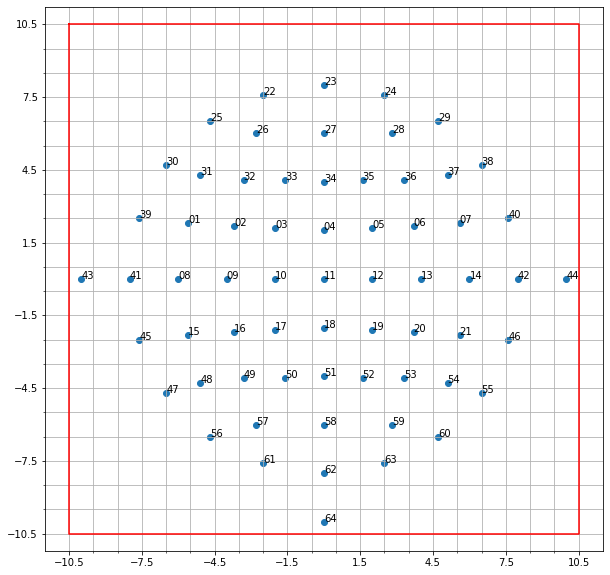

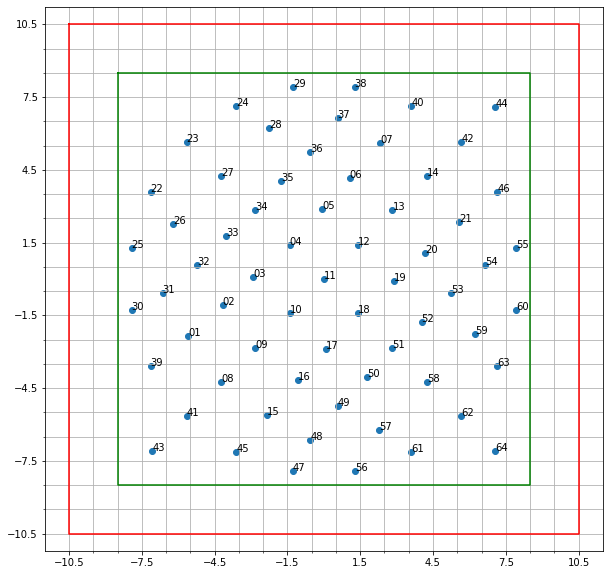

In [4]:
xp, yp = [], []

for i in range(1, C+1):
    xp.append(points[i][0])
    yp.append(points[i][1])

r45 = [False]
def rotate45(p):
    return np.sqrt(2)/2*np.array((p[0]-p[1], p[0]+p[1]))

r = 10
for points_r in [r*np.array((x, y)) for x, y in zip(xp, yp)], [r*rotate45((x, y)) for x, y in zip(xp, yp)]:
    px, py = [], []
    for p in points_r:
        px.append(p[0])
        py.append(p[1])
    
    plt.rcParams["figure.figsize"] = (10, 10)
    ax = plt.axes()
    ax.scatter(px, py)
    for idx, p in enumerate(points_r):
        ax.annotate(f"{idx+1:02}", p)        

    x_min = -(r+.5)
    x_max = (r+.5)
    y_min = -(r+.5)
    y_max = (r+.5)
    
    n = int(x_max-x_min)
    border = [(x_min+i, y_max) for i in range(n)] +\
             [(x_max, y_max-i) for i in range(n)] +\
             [(x_max-i, y_min) for i in range(n)] +\
             [(x_min, y_min+i) for i in range(n+1)]
    ax.plot([point[0] for point in border], [point[1] for point in border],  "r")
        
    ax.axis('equal')
    plt.xlim(x_min-1, x_max+1)
    plt.ylim(y_min-1, y_max+1)
    ax.set_xticks(np.arange(x_min, x_max+1, 3))
    ax.set_xticks(np.arange(x_min, x_max+1), minor=True)
    ax.set_yticks(np.arange(y_min, y_max+1, 3))
    ax.set_yticks(np.arange(y_min, y_max+1), minor=True)
    ax.grid(which='both')

    if r45[0]:
        x_min += r / 5
        x_max -= r / 5
        y_min += r / 5
        y_max -= r / 5
        
        n = int(x_max-x_min)
        border = [(x_min+i, y_max) for i in range(n)] +\
                 [(x_max, y_max-i) for i in range(n)] +\
                 [(x_max-i, y_min) for i in range(n)] +\
                 [(x_min, y_min+i) for i in range(n+1)]
        ax.plot([point[0] for point in border], [point[1] for point in border],  "g")
    
    plt.show()
        
    r45[0] = True

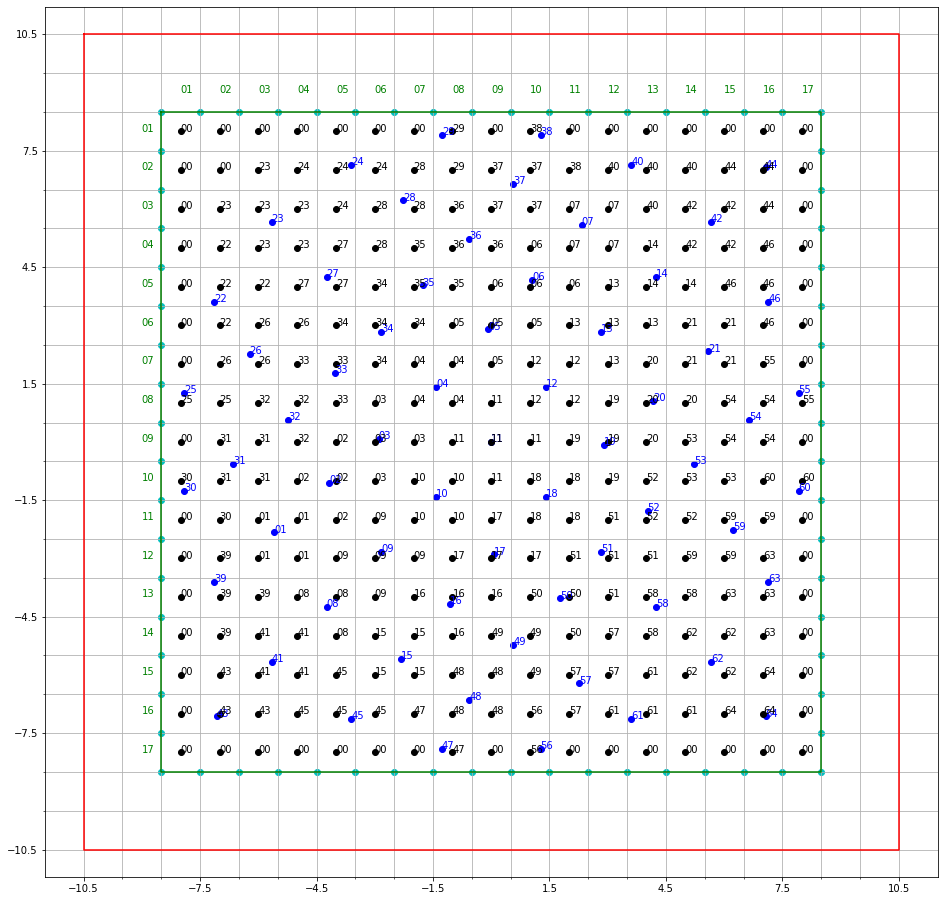

In [5]:
plt.rcParams["figure.figsize"] = (16, 16)
ax = plt.axes()     

x_min = -(r+.5)
x_max = (r+.5)
y_min = -(r+.5)
y_max = (r+.5)

n = int(x_max-x_min)
border = [(x_min+i, y_max) for i in range(n)] +\
         [(x_max, y_max-i) for i in range(n)] +\
         [(x_max-i, y_min) for i in range(n)] +\
         [(x_min, y_min+i) for i in range(n+1)]

ax.plot([point[0] for point in border], [point[1] for point in border],  "r")


ax.axis('equal')
plt.xlim(x_min-1, x_max+1)
plt.ylim(y_min-1, y_max+1)
ax.set_xticks(np.arange(x_min, x_max+1, 3))
ax.set_xticks(np.arange(x_min, x_max+1), minor=True)
ax.set_yticks(np.arange(y_min, y_max+1, 3))
ax.set_yticks(np.arange(y_min, y_max+1), minor=True)
ax.grid(which='both')
    
x_min += r / 5
x_max -= r / 5
y_min += r / 5
y_max -= r / 5

ax.scatter(px, py, c='b')
for idx, p in enumerate(points_r):
    ax.annotate(f"{idx+1:02}", p, c='b') 

for i in range(0, int(x_max-x_min)):
    ax.annotate(f"{i+1:02}", (x_min+.5+i, y_max+.5), c='g')
for i in range(0, int(y_max-y_min)):
    ax.annotate(f"{i+1:02}", (x_min-.5, y_max-.5-i), c='g')

n = int(x_max-x_min)
border = [(x_min+i, y_max) for i in range(n)] +\
         [(x_max, y_max-i) for i in range(n)] +\
         [(x_max-i, y_min) for i in range(n)] +\
         [(x_min, y_min+i) for i in range(n+1)]
ax.plot([point[0] for point in border], [point[1] for point in border],  "g")

pixels = [[x_min+.5+i, y_max-.5-j] for j in range(n) for i in range(n)]
for pixel in pixels:
    distances = np.linalg.norm(np.array(points_r)-np.array(pixel), axis=1)
    min_dist = distances.min()
    min_dist_idx = distances.argmin()+1
    distances = np.linalg.norm(np.array(border)-np.array(pixel), axis=1)
    min_dist_ = distances.min()
    if min_dist_ < min_dist:
         min_dist_idx = 0
    pixel.append(min_dist_idx)
ax.scatter([point[0] for point in pixels], [point[1] for point in pixels], c='k')
for p in pixels:
    ax.annotate(f"{p[2]:02}", p[:2])

border = border[:-1]
ax.scatter([point[0] for point in border], [point[1] for point in border], c='c')

plt.show()

pixels = np.array(pixels).reshape((n, n, 3))

### Raw data parsing

In [6]:
tio_data_to_extract = False
if tio_data_to_extract:
    t_data = []
    i_data = []
    o_data = []
    w = blackman(N)
    for S in os.scandir("files"):
        if S.name in ["S043", "S088", "S089", "S092", "S100", "S104", "S106"]:
            continue
        for R in os.scandir(S):
            if(R.path.endswith('.edf')):
                task = None
                for t, recs in zip(tasks, [recs_task2, recs_task4]):
                    for rec in recs:
                        if rec in R.path:
                            task = t
                            break
                if task:
                    print(R.name)
                    signals, signal_headers, header = read_edf(R.path)
                    for annotation in header['annotations']:
                        for i in range(10):
                            zt = []
                            zf = {band: [] for band in bands}
                            for signal in signals:
                                start = int(annotation[0] * fs + N * i)
                                end = start + N
                                y = signal[start:end]
                                zt.append(y)
                                yf = np.square(np.abs(2/N*fft(y*w)[:N//2])).astype('float32')
                                for band in bands:
                                    a, b = bands[band]
                                    zf[band].append(sum(yf[a:b]))
                            t_data.append(np.array(zt).astype('float32'))
                            i_data.append([zf[band] for band in bands])
                        o_data.append(tasks[task][annotation[2]])
    t_data = np.array(t_data)
    t_data = t_data.reshape((t_data.shape[0]//L, L, C, N))
    i_data = np.array(i_data)
    i_data = i_data.reshape((i_data.shape[0]//L, L, B, C))
    o_data = np.array(o_data)
    with tf.device('/cpu:0'):
        t_dataset = tf.data.Dataset.from_tensor_slices(t_data)
        i_dataset = tf.data.Dataset.from_tensor_slices(i_data)
        o_dataset = tf.data.Dataset.from_tensor_slices(o_data)
    tf.data.experimental.save(t_dataset, "t_dataset")
    tf.data.experimental.save(i_dataset, "i_dataset")
    tf.data.experimental.save(o_dataset, "o_dataset")
else:
    t_dataset = tf.data.experimental.load("t_dataset")
    i_dataset = tf.data.experimental.load("i_dataset")
    o_dataset = tf.data.experimental.load("o_dataset")
    t_data = np.array(list(t_dataset))
    i_data = np.array(list(i_dataset))
    o_data = np.array(list(o_dataset.as_numpy_iterator())).astype(str)
del t_dataset, i_dataset, o_dataset

### Data rescaling

In [7]:
t_std = t_data.std()
print(t_std)
t_data /= t_std

72.335754


In [8]:
i_std = i_data.std((0, 1, 3))
print(i_std)
for i in range(len(i_std)):
    i_data[:, :, i] /= i_std[i]

[4392.27370734 1092.39808504  627.72994599  345.57622865]


In [9]:
plt.rcParams["figure.figsize"] = (8, 8)

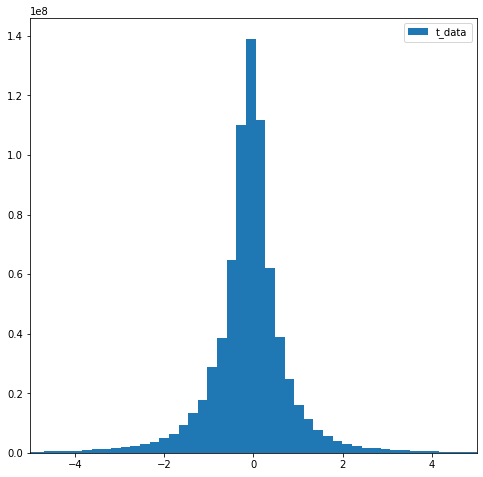

In [10]:
plt.hist(t_data.flatten(), bins=10**2, label='t_data')
plt.xlim(-5, 5)
plt.legend()
plt.show()

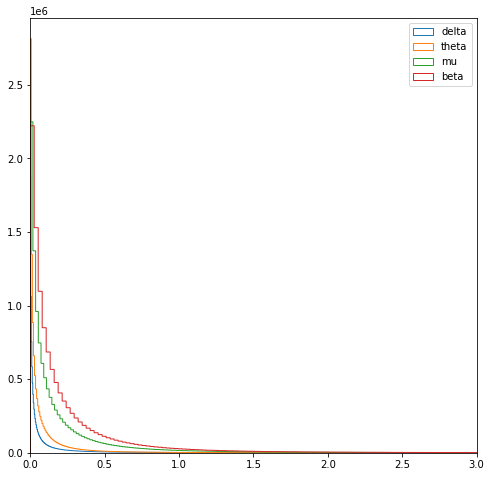

In [12]:
fig, ax = plt.subplots(nrows=1, ncols=1)
for idx, band in enumerate(bands):
    ax.hist(i_data[:,:,idx,:].flatten(), bins=10**4, histtype='step', label=band)
ax.legend()
plt.xlim(0, 3)
plt.show()

### Images and labels retrieval

In [ ]:
img_data_to_extract = False
if img_data_to_extract:
    i_data = i_data.reshape((i_data.shape[0]*L, B, C))
    img_data = np.zeros((*i_data.shape[:2], n, n)).astype('float32')
    step = i_data.shape[0]//100
    for i, z in enumerate(i_data):
        if i % step == 0:
            print(f"{100*i//i_data.shape[0]:2d}%")
        for idx, band in enumerate(bands):
            img_data[i, idx] = np.array([[z[idx, int(pixels[i, j, 2])-1] if pixels[i, j, 2] > 0 else 0 for j in range(n)] for i in range(n)])
    i_data = i_data.reshape((i_data.shape[0]//L, L, B, C))
    img_data = img_data.reshape((img_data.shape[0]//L, L, B, n, n))
    with tf.device('/cpu:0'):
        img_dataset = tf.data.Dataset.from_tensor_slices(img_data)
    tf.data.experimental.save(img_dataset, "img_dataset")
else:
    img_dataset = tf.data.experimental.load("img_dataset")
    img_data = np.array(list(img_dataset))
del img_dataset

In [ ]:
mov_data_to_extract = False
if mov_data_to_extract:
    mov_data = []
    for o in o_data:
        mov_data.append(classes[o])
    with tf.device('/cpu:0'):
        mov_dataset = tf.data.Dataset.from_tensor_slices(mov_data)
    tf.data.experimental.save(mov_dataset, "mov_dataset")
else:
    mov_dataset = tf.data.experimental.load("mov_dataset")
    mov_data = np.array(list(mov_dataset))
del mov_dataset

### Video 1

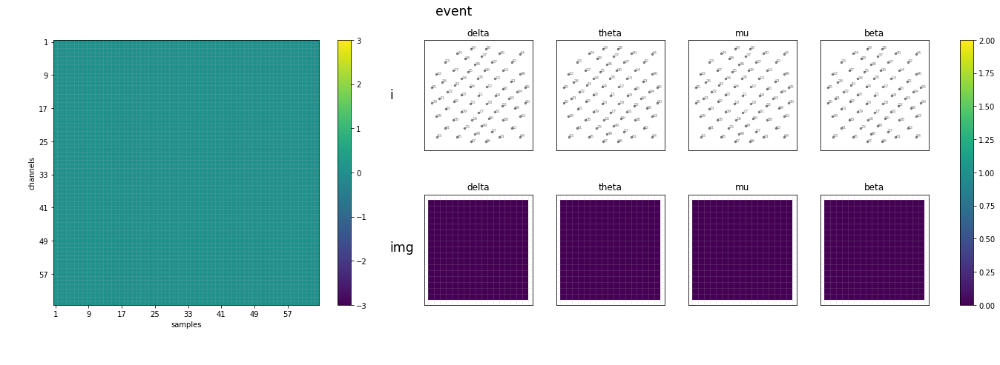

In [18]:
plt.rcParams["figure.figsize"] = (20, 6.8)
fig = plt.figure()
subfigs = fig.subfigures(1, 2, width_ratios=[1.5, 2.5])
axt = subfigs[0].subplots(nrows=1, ncols=1)
axs_ = subfigs[1].subplots(nrows=2, ncols=4)

quads = []
X0, Y0 = np.meshgrid(np.linspace(x_min+.5, x_max-.5), np.linspace(y_min+.5, y_max-.5))
X1, Y1 = np.meshgrid(np.linspace(x_min, x_max, n+1), np.linspace(y_min, y_max, n+1))
X2, Y2 = np.meshgrid(np.linspace(0, N, N+1), np.linspace(0, C, C+1))
for i in range(2):
    axs = axs_[i]
    for idx, band in enumerate(bands):
        if i:
            quads.append(axs[idx].pcolormesh(X1, np.flip(Y1, 0), np.zeros((n, n)), shading='auto', vmin=0, vmax=2))
            axs[idx].grid(which='both', alpha=.2)
        else:
            quads.append(axs[idx].pcolormesh(X0, Y0, np.full((50, 50), np.NaN), shading='auto', vmin=0, vmax=2))
            axs[idx].scatter(px, py, 10, 'k', linewidths=.2, alpha=.5)
            for idx_, p in enumerate(points_r):
                axs[idx].annotate(f"{idx_+1:02}", p, size='xx-small', alpha=.5)        

        axs[idx].set_title(band)
        axs[idx].axis('equal')
        axs[idx].axis([x_min, x_max, y_min, y_max])
        axs[idx].set_xticks([])#np.arange(x_min+1, x_max, 3))
        axs[idx].set_xticks(np.arange(x_min, x_max+1), minor=True)
        axs[idx].set_yticks([])#np.arange(y_min+1, y_max, 3))
        axs[idx].set_yticks(np.arange(y_min, y_max+1), minor=True)
        axs[idx].tick_params(axis='both', which='minor', length=0)

quads.append(axt.imshow(np.zeros((C, N)), vmin=-3, vmax=3))
axt.grid(which='minor', alpha=.2)
axt.set_xlabel("samples")
axt.set_ylabel("channels")
axt.set_xticks(np.arange(0, N, 8))
axt.set_xticklabels(np.arange(1, N+1, 8))
axt.set_xticks(np.arange(.5, N), minor=True)
axt.set_yticks(np.arange(0, C, 8))
axt.set_yticklabels(np.arange(1, C+1, 8))
axt.set_yticks(np.arange(.5, C), minor=True)
axt.tick_params(axis='both', which='minor', length=0)

fig.tight_layout(pad=4)
fig.colorbar(quads[0], ax=axs_)
fig.colorbar(quads[-1], ax=axt)
fig.text(.36, .72, "i", size='xx-large')
fig.text(.36, .30, "img", size='xx-large')
T = fig.suptitle("event", x=0.42, size='xx-large')
plt.show()

In [19]:
def init():
    for quad in quads[:-1]:
        quad.set_array(np.array([]))
    quads[-1].set_array(np.zeros((C, N)))
    return quads

In [20]:
def animate(i):
    if i % 10 == 0:
        T.set_text(o_data[i//10])
    z = np.copy(i_data[i//10, i%10])
    interp, Z = [{band: [] for band in bands} for idx in range(2)]
    for idx, band in enumerate(bands):
        interp[band] = CloughTocher2DInterpolator(list(zip(px, py)), z[idx])
        Z[band] = interp[band](X0, Y0)
        quads[idx].set_array(Z[band])
    for idx in range(B):
        quads[idx+B].set_array(img_data[i//10, i%10, idx])
    quads[-1].set_array(t_data[i//10, i%10])
    return quads

In [21]:
plt.rcParams['animation.embed_limit'] = 2**10
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=2*E*L, interval=400, blit=True)
video = anim.to_html5_video()
html = HTML(video)
display(html)

### Video 2

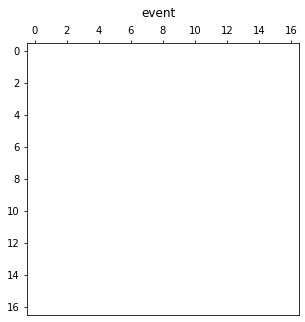

In [22]:
plt.rcParams["figure.figsize"] = (5, 5)
fig, ax = plt.subplots(nrows=1, ncols=1)
T = fig.suptitle("event")
img = ax.imshow(np.zeros((n, n, B)))
ax.xaxis.tick_top()

In [23]:
def init():
    img.set_data(np.zeros((n, n, B)))
    return img,

In [24]:
def animate(i):
    if i % L == 0:
        T.set_text(o_data[i//L])
    img.set_data(img_data[i//L,i%L].transpose(1, 2, 0).astype(float))
    return img,

In [25]:
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=2*E*L, interval=400, blit=True)
logger = logging.getLogger()
old_level = logger.level
logger.setLevel(100)
video = anim.to_html5_video()
logger.setLevel(old_level)
html = HTML(video)
display(html)

## Model design

In [3]:
def get_a(c):
    i = layers.Input(shape=(n, n, B) if c else (1, N, C))
    x = i
    for j in range(3):
        x = layers.Conv2D(filters_i*2**j, 3 if c else (1, 5), activation='relu', padding='same')(x)
        x = layers.MaxPool2D(2 if c else (1, 4), padding='same')(x)
    o = layers.Flatten()(x)
    return quantize_model(keras.Model(i, o))

def get_b():
    i = layers.Input(shape=(L, 10*filters_f))
    x = layers.Bidirectional(layers.LSTM(cells))(i)
    o = layers.Flatten()(x)
    return keras.Model(i, o)

def get_c(c):
    i = layers.Input(shape=(2*cells))
    x = layers.Dense(16, activation='relu')(i)
    o = layers.Dense(M if c else 1, activation='softmax' if c else 'sigmoid')(x)
    return quantize_model(keras.Model(i, o, name=f"o{c}"))

def get_c_():
    i = layers.Input(shape=(2*cells))
    x0 = layers.Dense(16, activation='relu')(i)
    x1 = layers.Dense(16, activation='relu')(i)
    o0 = layers.Dense(1)(x0)
    o1 = layers.Dense(M)(x1)
    o = layers.Concatenate(1)([o0, o1])
    return quantize_model(keras.Model(i, o))

def get_model():
    i0 = layers.Input(shape=(L, 1, N, C), name="i0")
    i1 = layers.Input(shape=(L, n, n, B), name="i1")
    a0 = get_a(0)
    a1 = get_a(1)
    x0 = []
    x1 = []
    for idx in range(i0.shape[1]):
        x0.append(a0(i0[:,idx]))
        x1.append(a1(i1[:,idx]))
    x0 = layers.Concatenate(1)(x0)
    x1 = layers.Concatenate(1)(x1)
    x0 = layers.Reshape((L, 1*filters_f))(x0)
    x1 = layers.Reshape((L, 9*filters_f))(x1)
    x = layers.Concatenate(-1)([x0, x1])
    x = get_b()(x)
    x = layers.Dropout(.5)(x)
    o0 = get_c(0)(x)
    o1 = get_c(1)(x)
    return keras.Model([i0, i1], [o0, o1])

m = get_model()
m.summary()
subj = 14
with tfmot.quantization.keras.quantize_scope():
    m.load_weights(f"m_{subj}.h5")

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 i0 (InputLayer)                [(None, 10, 1, 64,   0           []                               
                                64)]                                                              
                                                                                                  
 i1 (InputLayer)                [(None, 10, 17, 17,  0           []                               
                                 4)]                                                              
                                                                                                  
 tf.__operators__.getitem (Slic  (None, 1, 64, 64)   0           ['i0[0][0]']                     
 ingOpLambda)                                                                               

## Data preparation

In [4]:
t_dataset = tf.data.experimental.load("t_dataset")
img_dataset = tf.data.experimental.load("img_dataset")
mov_dataset = tf.data.experimental.load("mov_dataset")
t_data = np.array(list(t_dataset))
img_data = np.array(list(img_dataset))
mov_data = np.array(list(mov_dataset))
del t_dataset
del img_dataset
del mov_dataset

In [5]:
t_data /= t_data.std()
t_data = t_data.transpose(0, 1, 3, 2)
img_data = img_data.transpose(0, 1, 3, 4, 2)
mov_data0 = (mov_data != 0)
mov_data1 = np.array([tf.one_hot(dat-1, M) if dat else [.25 for i in range(M)] for dat in mov_data])

In [6]:
t_data = t_data.reshape((S, R, E, L, 1, N, C))
img_data = img_data.reshape((S, R, E, L, n, n, B))
mov_data = mov_data.reshape((S, R, E))
mov_data0 = mov_data0.reshape((S, R, E))
mov_data1 = mov_data1.reshape((S, R, E, M))

In [7]:
print(t_data.shape)
print(img_data.shape)
print(mov_data0.shape)
print(mov_data1.shape)

(102, 6, 30, 10, 1, 64, 64)
(102, 6, 30, 10, 17, 17, 4)
(102, 6, 30)
(102, 6, 30, 4)


## Training, validation and testing

In [8]:
def categorical_crossentropy(y_true, y_pred):
    return tf.keras.losses.CategoricalCrossentropy()(y_true[1::2], y_pred[1::2])

def categorical_accuracy(y_true, y_pred):
    return tf.reduce_mean(
                tf.cast(
                    tf.math.equal(
                        tf.math.argmax(y_true[1::2], axis=1), tf.math.argmax(y_pred[1::2], axis=1)
                    ), tf.float32
                )
            )

In [9]:
m = get_model()
m.compile(
    optimizer="Nadam",
    loss={
        "o0": "binary_crossentropy",
        "o1": categorical_crossentropy
    },
    metrics={
        "o0": "binary_accuracy",
        "o1": categorical_accuracy
    }
)

In [10]:
def sv(v, s):
    return np.concatenate((v[:s], v[s+s_block:S]))

In [11]:
extract_models=False
epochs = 100
batch_size=R*E
s_block = 6

if extract_models:
    val_accs = []
    eps_best = []
    for s in range(0, S, s_block):
        print(f"s: {s:3d}")
        
        x0 = sv(t_data, s).reshape(((S-s_block)*R*E, L, 1, N, C))
        x1 = sv(img_data, s).reshape(((S-s_block)*R*E, L, n, n, B))
        x = (x0, x1)
        y0 = sv(mov_data0, s).reshape(((S-s_block)*R*E))
        y1 = sv(mov_data1, s).reshape(((S-s_block)*R*E, M))
        y = (y0, y1)
        validation_data0= []
        validation_data1= []
        validation_data= []
        test_data = []
        for sb in range(s_block):
            
            iv0 = t_data[s+sb, :RT//2].reshape((1*RT//2*E, L, 1, N, C))
            iv1 = img_data[s+sb, :RT//2].reshape((1*RT//2*E, L, n, n, B))
            i_val = (iv0, iv1)
            ov0 = mov_data0[s+sb, :RT//2].reshape((1*RT//2*E))
            ov1 = mov_data1[s+sb, :RT//2].reshape((1*RT//2*E, M))
            o_val = (ov0, ov1)

            validation_data0.append((i_val, o_val))
            
            iv0 = t_data[s+sb, RT//2:RT].reshape((1*RT//2*E, L, 1, N, C))
            iv1 = img_data[s+sb, RT//2:RT].reshape((1*RT//2*E, L, n, n, B))
            i_val = (iv0, iv1)
            ov0 = mov_data0[s+sb, RT//2:RT].reshape((1*RT//2*E))
            ov1 = mov_data1[s+sb, RT//2:RT].reshape((1*RT//2*E, M))
            o_val = (ov0, ov1)

            validation_data1.append((i_val, o_val)) 
            
            k_validation_data = [validation_data0, validation_data1]
            
            iv0 = t_data[s+sb, :RT].reshape((1*RT*E, L, 1, N, C))
            iv1 = img_data[s+sb, :RT].reshape((1*RT*E, L, n, n, B))
            i_val = (iv0, iv1)
            ov0 = mov_data0[s+sb, :RT].reshape((1*RT*E))
            ov1 = mov_data1[s+sb, :RT].reshape((1*RT*E, M))
            o_val = (ov0, ov1)

            validation_data.append((i_val, o_val))
            
            it0 = t_data[s+sb, RT:].reshape((1*(R-RT)*E, L, 1, N, C))
            it1 = img_data[s+sb, RT:].reshape((1*(R-RT)*E, L, n, n, B))
            i_tst = (it0, it1)
            ot0 = mov_data0[s+sb, RT:].reshape((1*(R-RT)*E))
            ot1 = mov_data1[s+sb, RT:].reshape((1*(R-RT)*E, M))
            o_tst = (ot0, ot1)

            test_data.append((i_tst, o_tst))

        with tfmot.quantization.keras.quantize_scope():
            m = get_model()
            m.compile(
                optimizer="Nadam",
                loss={
                    "o0": "binary_crossentropy",
                    "o1": categorical_crossentropy
                },
                metrics={
                    "o0": "binary_accuracy",
                    "o1": categorical_accuracy
                }
            )
            
            # pre training and validation
            callbacks = [
                tf.keras.callbacks.ModelCheckpoint(
                    "m/t/m_{epoch}.h5",
                    save_weights_only=True
                )
            ]
            #m.load_weights("mt/m_.h5")
            m.fit(x, y, batch_size=batch_size, epochs=epochs, callbacks=callbacks, shuffle=False)
            for sb in range(s_block):
                print(f"sb: {sb}")
                accv_max = 0
                accvk_max = [0, 0]
                accf_max = 0
                best_ep = [0, 0]
                for f in os.scandir('m/t/'):
                    if "checkpoint" not in f.name:
                        m.load_weights(f.path)
                        a = m.predict(validation_data[sb][0])
                        b = [0 if a[0][i] < .5 else a[1][i].argmax()+1 for i in range(len(a[0]))]
                        accv = sum(np.equal(b, mov_data[s+sb, :RT].flatten()))/(RT*E)
                        if accv > accv_max:
                            print("val_acc:", accv)
                            accv_max = accv
                            path = f.path
                val_accs.append(accv_max)
                
                callbacks = [
                    tf.keras.callbacks.ModelCheckpoint(
                        "m/v/m_{epoch}.h5",
                        save_weights_only=True
                    )
                ]
                for k in range(K):
                    m.load_weights(path)
                    print("...", end='\r')
                    m.fit(*(k_validation_data[k][sb]), validation_data=k_validation_data[K-k-1][sb], batch_size=batch_size, epochs=epochs, callbacks=callbacks, shuffle=False, verbose=0)
                    print(f"done {k}")
                    for f in os.scandir('m/v/'):
                        if "checkpoint" not in f.name:
                            m.load_weights(f.path)
                            a = m.predict(k_validation_data[K-k-1][sb][0])
                            b = [0 if a[0][i] < .5 else a[1][i].argmax()+1 for i in range(len(a[0]))]
                            accvk = sum(np.equal(b, mov_data[s+sb, RT:].flatten()))/((R-RT)*E)
                            if accvk > accvk_max[k]:
                                print(f"k{k}_acc :", accvk)
                                accvk_max[k] = accvk
                                best_ep[k] = int(f.name[2:-3])
                ep_best = round(np.mean(best_ep))
                print("ep_best:", ep_best)
                eps_best.append(ep_best)
                
                # final training and testing
                m.load_weights(path)
                print("...", end='\r')
                m.fit(*(validation_data[sb]), validation_data=test_data[sb], batch_size=batch_size, epochs=epochs, callbacks=callbacks, shuffle=False, verbose=0)
                print(f"done")
                
                m.load_weights(f"m/v/m_{ep_best}.h5")
                a = m.predict(test_data[sb][0])
                b = [0 if a[0][i] < .5 else a[1][i].argmax()+1 for i in range(len(a[0]))]
                tst_acc = sum(np.equal(b, mov_data[s+sb, RT:].flatten()))/((R-RT)*E)
                print("tst_acc:", tst_acc)
                m.save_weights(f"m/f/a/m_{s+sb}.h5")
                
                # find best
                for f in os.scandir('m/v/'):
                    if "checkpoint" not in f.name:
                        m.load_weights(f.path)
                        a = m.predict(test_data[sb][0])
                        b = [0 if a[0][i] < .5 else a[1][i].argmax()+1 for i in range(len(a[0]))]
                        accf = sum(np.equal(b, mov_data[s+sb, RT:].flatten()))/((R-RT)*E)
                        if accf > accf_max:
                            print("best_tst_acc:", accf)
                            accf_max = accf
                            m.save_weights(f"m/f/b/m_{s+sb}.h5")

                print(s+sb, tst_acc, accf_max)
    
    np.savetxt("val_accs.csv", val_accs, delimiter=',')
    np.savetxt("eps_best.csv", eps_best, delimiter=',')

In [66]:
x = []
labels = []
predictions = []
with tfmot.quantization.keras.quantize_scope():
    m = get_model()
    for f in os.scandir('m/f/b'):
        if 'checkpoint' not in f.name:
            nm = int(f.name.split('_')[1][:-3])

            it0 = t_data[nm, RT:].reshape((1*(R-RT)*E, L, 1, N, C))
            it1 = img_data[nm, RT:].reshape((1*(R-RT)*E, L, n, n, B))
            i_tst = [it0, it1]
            ot0 = mov_data0[nm, RT:].reshape((1*(R-RT)*E))
            ot1 = mov_data1[nm, RT:].reshape((1*(R-RT)*E, B))
            o_tst = (ot0, ot1)

            test_data = (i_tst, o_tst)

            m.load_weights(f.path)

            p = m.predict(test_data[0])
            pred = [0 if p[0][i] < .5 else p[1][i].argmax()+1 for i in range((R-RT)*E)]
            l = mov_data[nm, RT:].flatten()
            s = sum(np.equal(l, pred))/((R-RT)*E)
            x.append((nm, s))
            print(f"{nm:03} {s:.2f}")
            
            labels.extend(l)
            predictions.extend(pred)
x.sort()
x = np.array(x)

000 0.80
001 0.72
010 0.63
100 0.62
101 0.45
011 0.87
012 0.68
013 0.62
014 0.92
015 0.62
016 0.70
017 0.87
018 0.72
019 0.87
002 0.73
020 0.68
021 0.82
022 0.62
023 0.48
024 0.67
025 0.60
026 0.80
027 0.67
028 0.78
029 0.72
003 0.82
030 0.53
031 0.80
032 0.80
033 0.82
034 0.83
035 0.75
036 0.75
037 0.50
038 0.58
039 0.82
004 0.68
040 0.82
041 0.70
042 0.73
043 0.75
044 0.67
045 0.57
046 0.70
047 0.72
048 0.75
049 0.95
005 0.80
050 0.78
051 0.73
052 0.83
053 0.92
054 0.72
055 0.90
056 0.77
057 0.62
058 0.83
059 0.78
006 0.87
060 0.75
061 0.78
062 0.78
063 0.88
064 0.67
065 0.72
066 0.82
067 0.82
068 0.92
069 0.70
007 0.82
070 0.85
071 0.72
072 0.60
073 0.42
074 0.57
075 0.65
076 0.52
077 0.62
078 0.80
079 0.80
008 0.67
080 0.77
081 0.62
082 0.60
083 0.78
084 0.85
085 0.55
086 0.80
087 0.78
088 0.72
089 0.72
009 0.58
090 0.62
091 0.67
092 0.73
093 0.47
094 0.55
095 0.93
096 0.80
097 0.65
098 0.58
099 0.43


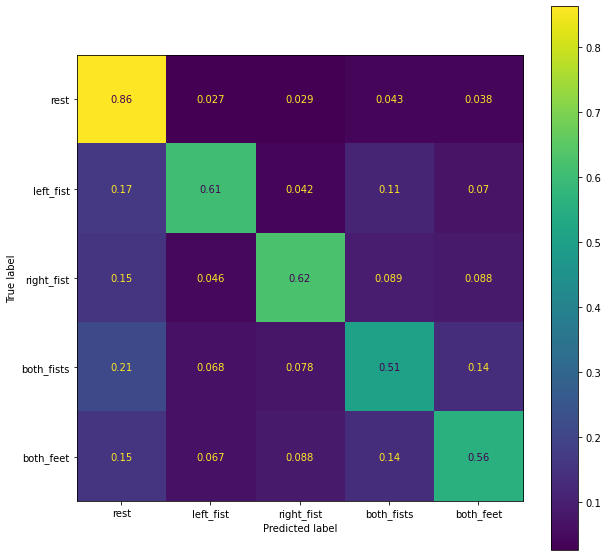

In [67]:
plt.rcParams["figure.figsize"] = (10, 10)
ConfusionMatrixDisplay.from_predictions(labels, predictions, display_labels=classes, normalize='true')
plt.show()

In [68]:
np.savetxt("csv/better_tst_accs.csv", x, delimiter=',')

In [69]:
x = np.loadtxt("csv/better_tst_accs.csv", delimiter=',')

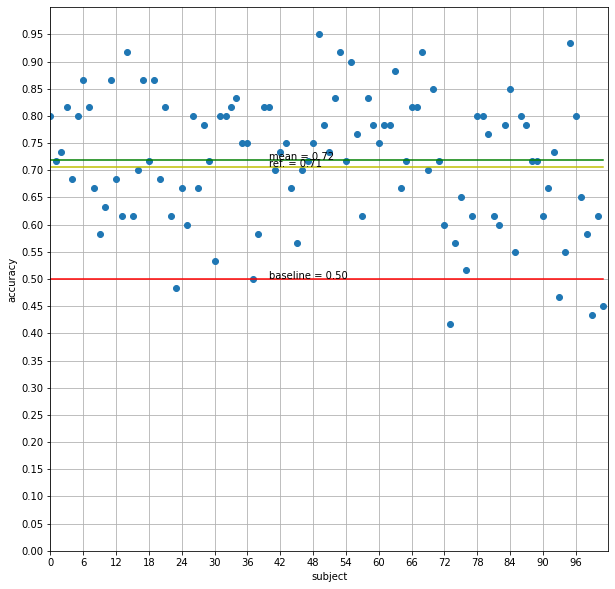

In [70]:
x_mean = x.mean(axis=0)[1]
mean_ref = .7063

plt.rcParams["figure.figsize"] = (10, 10)
plt.xlabel("subject")
plt.ylabel("accuracy")
plt.plot(x[:,0], x[:,1], 'o')
plt.plot(x[:,0], [.5 for i in range(len(x[:,0]))], 'r')
plt.plot(x[:,0], [mean_ref for i in range(len(x[:,0]))], 'y')
plt.plot(x[:,0], [x_mean for i in range(len(x[:,0]))], 'g')
plt.xlim([0, 102])
plt.ylim([0, 1])

plt.annotate(f"baseline = {.5:.2f}", (40, .5))
plt.annotate(f"ref. = {mean_ref:.2f}", (40, mean_ref))
plt.annotate(f"mean = {x_mean:.2f}", (40, x_mean))
plt.xticks(np.arange(0, 102, 6))
plt.yticks(np.arange(0, 1, .05))
plt.grid()
plt.show()

In [72]:
x = np.loadtxt("csv/val_accs.csv", delimiter=',')

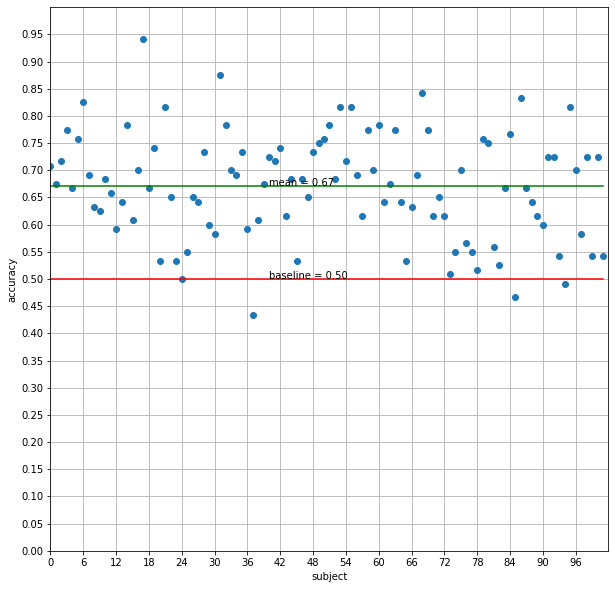

In [79]:
x_mean = x.mean()
mean_ref = .7063

plt.rcParams["figure.figsize"] = (10, 10)
plt.xlabel("subject")
plt.ylabel("accuracy")
plt.plot(range(len(x)), x, 'o')
plt.plot(range(len(x)), [.5 for i in range(len(x))], 'r')
plt.plot(range(len(x)), [x_mean for i in range(len(x))], 'g')
plt.xlim([0, 102])
plt.ylim([0, 1])

plt.annotate(f"baseline = {.5:.2f}", (40, .5))
plt.annotate(f"mean = {x_mean:.2f}", (40, x_mean))
plt.xticks(np.arange(0, 102, 6))
plt.yticks(np.arange(0, 1, .05))
plt.grid()
plt.show()

In [80]:
x = np.loadtxt("csv/eps_best.csv", delimiter=',')

In [83]:
round(x.mean())

34

## Optimization and quantization

### Blocks extration

In [39]:
get_models = False
m = get_model()
subj = 14
with tfmot.quantization.keras.quantize_scope():
    m.load_weights(f"m/f/a/m_{subj}.h5")

In [41]:
if get_models:
    with tfmot.quantization.keras.quantize_scope():
        for c in range(2):
            a = get_a(c)
            a.set_weights(m.layers[-11+c].get_weights())
            converter = tf.lite.TFLiteConverter.from_keras_model(a)
            converter.optimizations = [tf.lite.Optimize.DEFAULT]
            #converter.inference_input_type = tf.int8
            tflite_model = converter.convert()
            with open(f"m_blocks/a{c}_quant.tflite", "wb") as f:
                f.write(tflite_model)

INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmp3uxbvns9\assets


INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmp3uxbvns9\assets
D:\ProgramData\Anaconda3\envs\MLonMCU\lib\site-packages\tensorflow\lite\python\convert.py:746: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn("Statistics for quantized inputs were expected, but not "


INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmpiv_abzer\assets


INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmpiv_abzer\assets
D:\ProgramData\Anaconda3\envs\MLonMCU\lib\site-packages\tensorflow\lite\python\convert.py:746: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn("Statistics for quantized inputs were expected, but not "


In [42]:
if get_models:
    b = get_b()
    b.set_weights(m.layers[-4].get_weights())
    b.save("m_blocks/b.h5")

In [43]:
if get_models:
    with tfmot.quantization.keras.quantize_scope():
        c = get_c_()
        c.layers[-6].set_weights(m.layers[-2].layers[1].get_weights())
        c.layers[-5].set_weights(m.layers[-2].layers[2].get_weights())
        c.layers[-4].set_weights(m.layers[-1].layers[2].get_weights())
        c.layers[-3].set_weights(m.layers[-2].layers[3].get_weights())
        c.layers[-2].set_weights(m.layers[-1].layers[3].get_weights())
        converter = tf.lite.TFLiteConverter.from_keras_model(c)
        converter.optimizations = [tf.lite.Optimize.DEFAULT]
        converter.inference_output_type = tf.int8
        tflite_model = converter.convert()
        with open(f"m_blocks/c_quant.tflite", "wb") as f:
            f.write(tflite_model)

INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmph9wvtaop\assets


INFO:tensorflow:Assets written to: C:\Users\oscar\AppData\Local\Temp\tmph9wvtaop\assets
D:\ProgramData\Anaconda3\envs\MLonMCU\lib\site-packages\tensorflow\lite\python\convert.py:746: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn("Statistics for quantized inputs were expected, but not "


### quant to float x_acc

In [44]:
a0 = get_a(0)
a0.set_weights(m.layers[-11].get_weights())
a1 = get_a(1)
a1.set_weights(m.layers[-10].get_weights())
b = get_b()
b.set_weights(m.layers[-4].get_weights())
c = get_c_()
c.layers[-6].set_weights(m.layers[-2].layers[1].get_weights())
c.layers[-5].set_weights(m.layers[-2].layers[2].get_weights())
c.layers[-4].set_weights(m.layers[-1].layers[2].get_weights())
c.layers[-3].set_weights(m.layers[-2].layers[3].get_weights())
c.layers[-2].set_weights(m.layers[-1].layers[3].get_weights())

In [45]:
it0 = t_data[subj, RT:].reshape((1*(R-RT)*E, L, 1, N, C))
it1 = img_data[subj, RT:].reshape((1*(R-RT)*E, L, n, n, B))
i_tst = (it0, it1)
ot0 = mov_data0[subj, RT:].reshape((1*(R-RT)*E))
ot1 = mov_data1[subj, RT:].reshape((1*(R-RT)*E, B))
o_tst = (ot0, ot1)
test_data = (i_tst, o_tst)

In [46]:
pred_raw = m.predict(test_data[0])
pred = [0 if pred_raw[0][i] < .5 else pred_raw[1][i].argmax()+1 for i in range((R-RT)*E)]
acc = sum(np.equal(pred, mov_data[subj, RT:].flatten()))/((R-RT)*E)
print("acc:", acc)

acc: 0.9166666666666666


In [47]:
with open("m_blocks/a0_quant.tflite", "rb") as f:
    a0_quant = f.read()
with open("m_blocks/a1_quant.tflite", "rb") as f:
    a1_quant = f.read()
with open("m_blocks/c_quant.tflite", "rb") as f:
    c_quant = f.read()

In [48]:
sample=0
a0_out = a0.predict(test_data[0][0][sample]).reshape((1, 10, 32))
a1_out = a1.predict(test_data[0][1][sample]).reshape((1, 10, 288))
a_out = np.concatenate((a0_out, a1_out), -1)
b_out = b.predict(a_out)
c_out = c.predict(b_out)

In [49]:
np.set_printoptions(suppress=True)

In [50]:
t = 60
count = 0
quant_pred = []
for sample in range(t):
    print(f"{sample:2}", end='\r')
    a0_out = a0.predict(test_data[0][0][sample]).reshape((1, 10, 32))
    a1_out = a1.predict(test_data[0][1][sample]).reshape((1, 10, 288))
    a_out = np.concatenate((a0_out, a1_out), -1)
    b_out = b.predict(a_out)
    c_out = c.predict(b_out)
    a0_quant_out = []
    a1_quant_out = []
    for j in range(2):
        for i in range(L):
            interpreter = tf.lite.Interpreter(model_content=a0_quant if not j else a1_quant)
            interpreter.allocate_tensors()
            input_details = interpreter.get_input_details()[0]
            output_details = interpreter.get_output_details()[0]
            x = test_data[0][j][sample, i]
            #scale, zero_point = input_details['quantization']
            #x = np.rint(test_data[0][sample, i]/scale+zero_point).astype('int8')
            x = np.expand_dims(x, 0)
            interpreter.set_tensor(input_details["index"], x)
            interpreter.invoke()
            y = interpreter.get_tensor(output_details["index"])[0]
            if not j:
                a0_quant_out.append(y)
            else:
                a1_quant_out.append(y)
    a0_quant_out = np.expand_dims(a0_quant_out, axis=0)
    a1_quant_out = np.expand_dims(a1_quant_out, axis=0)
    a_quant_out = np.concatenate((a0_quant_out, a1_quant_out), -1)
    
    b_quant_out = b.predict(a_quant_out)
    
    interpreter = tf.lite.Interpreter(model_content=c_quant)
    interpreter.allocate_tensors()
    input_details = interpreter.get_input_details()[0]
    output_details = interpreter.get_output_details()[0]
    x = b_quant_out
    interpreter.set_tensor(input_details["index"], x)
    interpreter.invoke()
    y = interpreter.get_tensor(output_details["index"])[0]
    
    output_scale, output_zero_point = output_details["quantization"]
    c_quant_out = (y-output_zero_point)*output_scale
    
    o0_ref = c_out[0][0] > 0
    o0_res = c_quant_out[0] > 0
    o1_ref = c_out[0][1:].argmax()+1
    o1_res = c_quant_out[1:].argmax()+1
    out_ref = o1_ref if o0_ref else o0_ref
    out_res = o1_res if o0_res else o0_res
    quant_pred.append(out_res)
    if out_res == out_ref:
        count+=1
    else:
        print(f"{sample:2}")
        print(c_out[0][0])
        print(c_quant_out[0])
        print(c_out[0][1:])
        print(c_quant_out[1:])
    
print("quant to float x_acc:", count/t)
acc = sum(np.equal(pred, mov_data[subj, RT:].flatten()))/((R-RT)*E)
print("float_acc:", acc)
quant_acc = sum(np.equal(quant_pred, mov_data[subj, RT:].flatten()))/((R-RT)*E)
print("quant_acc:", quant_acc)

quant to float x_acc: 1.0
float_acc: 0.9166666666666666
quant_acc: 0.9166666666666666


In [51]:
mov_data[subj, RT:].flatten()

array([0, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 0, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 3, 0, 4, 0, 3, 0, 3, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4])

In [52]:
np.array(pred).flatten()

array([3, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 3, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 2, 0, 4, 2, 3, 0, 0, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4], dtype=int64)

In [53]:
np.array(quant_pred).flatten()

array([3, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 3, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 2, 0, 4, 2, 3, 0, 0, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4], dtype=int64)

## DEMO

In [62]:
s = serial.Serial(
    port='COM3',
    baudrate=115200*16,
    parity=serial.PARITY_NONE,
    stopbits=serial.STOPBITS_ONE,
    bytesize=serial.EIGHTBITS,
    timeout=0
)

print("connected to: " + s.portstr)

connected to: COM3


In [63]:
#s.close()

In [64]:
def read_from_buffer(length, dtype='float32'):
    buf = s.read(length)
    while len(buf) < length:
        buf += s.read(length-len(buf))
    return np.frombuffer(buf, dtype=dtype) 

In [66]:
prep = True
s.read(2**20)
stm_pred = []
if prep:
    test_sign_paths = ["files/S015/S015R12.edf", "files/S015/S015R14.edf"]
    for sign_n in range(2):
        signals, signal_headers, header = read_edf(test_sign_paths[sign_n])
        for i in range(30):
            t_start = time()
            t0 = int(header["annotations"][i][0]*160)
            for j in range(10):
                for idx, signal in enumerate(signals):
                    s.write(signal[t0+j*N:t0+(j+1)*N].astype('float32').tobytes())
                    res = read_from_buffer(1, 'int8')[0]
                res = read_from_buffer(1, 'int8')[0]
            t_end = time()
            #print(t_end-t_start)
            stm_pred.append(read_from_buffer(1, 'int8')[0])
            print(f"stm_pred:[{sign_n*E+i}]", stm_pred[sign_n*E+i])
    stm_pred = np.array(stm_pred)
else:
    interpreter = tf.lite.Interpreter(model_content=a_quant)
    interpreter.allocate_tensors()
    input_details = interpreter.get_input_details()[0]
    scale , zero_point = input_details["quantization"]
    for sign_n in range(2):
        signals, signal_headers, header = read_edf(test_sign_paths[sign_n])
        for i in range(30):
            for j in range(10):
                x = np.rint(test_data[0][sign_n*E+i, j]/scale+zero_point).astype('int8')
                s.write(x.tobytes())
                res = read_from_buffer(1, 'int8')[0]
            stm_pred.append(read_from_buffer(1, 'int8')[0])
            print(f"stm_pred:[{sign_n*E+i}]", stm_pred[sign_n*E+i])
    stm_pred = np.array(stm_pred)

stm_pred:[0] 3
stm_pred:[1] 2
stm_pred:[2] 0
stm_pred:[3] 1
stm_pred:[4] 0
stm_pred:[5] 2
stm_pred:[6] 0
stm_pred:[7] 1
stm_pred:[8] 0
stm_pred:[9] 1
stm_pred:[10] 0
stm_pred:[11] 2
stm_pred:[12] 3
stm_pred:[13] 2
stm_pred:[14] 0
stm_pred:[15] 1
stm_pred:[16] 0
stm_pred:[17] 2
stm_pred:[18] 0
stm_pred:[19] 1
stm_pred:[20] 0
stm_pred:[21] 1
stm_pred:[22] 0
stm_pred:[23] 2
stm_pred:[24] 0
stm_pred:[25] 1
stm_pred:[26] 0
stm_pred:[27] 2
stm_pred:[28] 0
stm_pred:[29] 1
stm_pred:[30] 0
stm_pred:[31] 4
stm_pred:[32] 0
stm_pred:[33] 2
stm_pred:[34] 0
stm_pred:[35] 4
stm_pred:[36] 0
stm_pred:[37] 3
stm_pred:[38] 0
stm_pred:[39] 0
stm_pred:[40] 0
stm_pred:[41] 4
stm_pred:[42] 0
stm_pred:[43] 3
stm_pred:[44] 0
stm_pred:[45] 4
stm_pred:[46] 0
stm_pred:[47] 3
stm_pred:[48] 0
stm_pred:[49] 4
stm_pred:[50] 0
stm_pred:[51] 3
stm_pred:[52] 0
stm_pred:[53] 4
stm_pred:[54] 0
stm_pred:[55] 4
stm_pred:[56] 0
stm_pred:[57] 3
stm_pred:[58] 0
stm_pred:[59] 4


In [67]:
pred = np.array(pred)
stm_pred = np.array(stm_pred)
print("stm to quant x_acc:", sum(stm_pred == quant_pred)/((R-RT)*E))

stm to quant x_acc: 0.9833333333333333


In [68]:
stm_acc = sum(np.equal(stm_pred, mov_data[subj, RT:].flatten()))/((R-RT)*E)
print("stm_acc:", stm_acc)

stm_acc: 0.9333333333333333


In [51]:
mov_data[subj, RT:].flatten()

array([0, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 0, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 3, 0, 4, 0, 3, 0, 3, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4])

In [52]:
np.array(pred).flatten()

array([3, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 3, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 2, 0, 4, 2, 3, 0, 0, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4], dtype=int64)

In [69]:
np.array(quant_pred).flatten()

array([3, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 3, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 2, 0, 4, 2, 3, 0, 0, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4], dtype=int64)

In [70]:
np.array(stm_pred).flatten()

array([3, 2, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 3, 2, 0, 1, 0, 2, 0, 1, 0, 1,
       0, 2, 0, 1, 0, 2, 0, 1, 0, 4, 0, 2, 0, 4, 0, 3, 0, 0, 0, 4, 0, 3,
       0, 4, 0, 3, 0, 4, 0, 3, 0, 4, 0, 4, 0, 3, 0, 4], dtype=int8)